In [2]:
import pandas as pd
import matplotlib.pyplot as plt
import folium
from folium.plugins import HeatMap
from bs4 import BeautifulSoup 
import requests
import seaborn as sns
import warnings
import calendar

warnings.filterwarnings("ignore")

In [3]:
accidentes= pd.read_csv('./DATA/accidentes.csv')


In [4]:
accidentes

,ID,VICTIMAS,FECHA,ANIO,MES,DIA,HORA,MEDIO,COMUNA,X,Y,PARTICIPANTES,ACUSADO,ROL,DAMNIFICADO,SEXO,EDAD,OBITO
0,2016-0001,1,2016-01-01,2016,1,1,04:00:00,AVENIDA,8,-58.475340,-34.687570,MOTO-AUTO,AUTO,CONDUCTOR,MOTO,MASCULINO,19,1
1,2016-0002,1,2016-01-02,2016,1,2,01:15:00,AUTOPISTA,9,-58.508775,-34.669777,AUTO-PASAJEROS,PASAJEROS,CONDUCTOR,AUTO,MASCULINO,70,1
2,2016-0003,1,2016-01-03,2016,1,3,07:00:00,AVENIDA,1,-58.390403,-34.631894,MOTO-AUTO,AUTO,CONDUCTOR,MOTO,MASCULINO,30,1
3,2016-0004,1,2016-01-10,2016,1,10,00:00:00,AVENIDA,8,-58.465039,-34.680930,MOTO-SD,DESCONOCIDO,CONDUCTOR,MOTO,MASCULINO,18,1
4,2016-0005,1,2016-01-21,2016,1,21,05:20:00,AVENIDA,1,-58.387183,-34.622466,MOTO-PASAJEROS,PASAJEROS,CONDUCTOR,MOTO,MASCULINO,29,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
26556,LC-2021-0652849,1,2021-12-31,2021,12,31,19:30:00,AVENIDA,9,-58.513477,-34.659714,MOTO,DESCONOCIDO,DESCONOCIDO,DESCONOCIDO,MASCULINO,29,0
26557,LC-2021-0652865,2,2021-12-31,2021,12,31,19:40:00,AVENIDA,9,-58.488327,-34.641753,MOTO,DESCONOCIDO,DESCONOCIDO,DESCONOCIDO,MASCULINO,28,0
26558,LC-2021-0652865,2,2021-12-31,2021,12,31,19:40:00,AVENIDA,9,-58.488327,-34.641753,MOTO,DESCONOCIDO,DESCONOCIDO,DESCONOCIDO,MASCULINO,52,0
26559,LC-2021-0652907,1,2021-12-31,2021,12,31,20:00:00,DESCONOCIDO,1,-58.382894,-34.583083,MOTO,DESCONOCIDO,DESCONOCIDO,DESCONOCIDO,MASCULINO,23,0


In [8]:
accidentes['FECHA'] = pd.to_datetime(accidentes['FECHA'], errors='coerce')

In [9]:
accidentes['SEMESTRE'] = (accidentes['FECHA'].dt.month - 1) // 6 + 1


In [10]:
accidentes_obitos= accidentes[accidentes['OBITO'] == 1].copy()
accidentes_lesiones= accidentes[accidentes['OBITO'] == 0].copy()

### VICTIMAS POR COMUNA

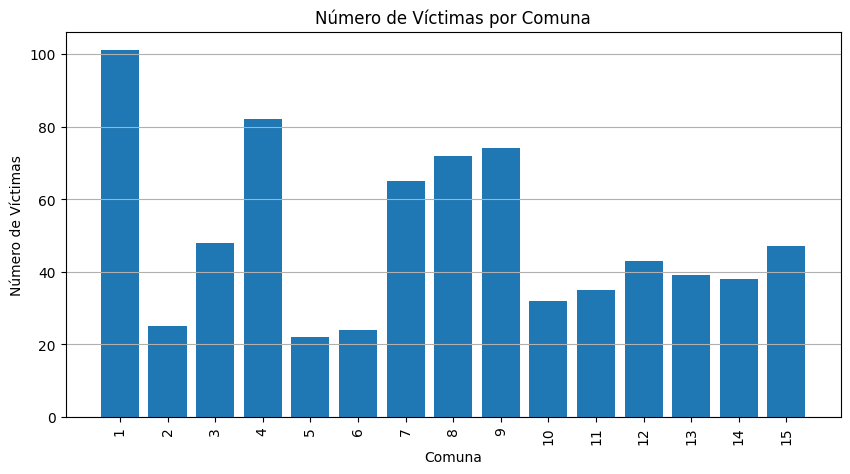

In [11]:

# Agrupa por comuna y suma las víctimas
victimas_por_comuna = accidentes_obitos.groupby('COMUNA')['VICTIMAS'].sum().reset_index()

# Filtrar comunas con víctimas
victimas_por_comuna = victimas_por_comuna[victimas_por_comuna['VICTIMAS'] > 0]

# Ajustar los índices para que coincidan con la posición en el eje x
victimas_por_comuna = victimas_por_comuna.reset_index(drop=True)

# Crea la gráfica de barras
plt.figure(figsize=(10, 5))
bars = plt.bar(victimas_por_comuna.index, victimas_por_comuna['VICTIMAS'])
plt.title('Número de Víctimas por Comuna')
plt.xlabel('Comuna')
plt.ylabel('Número de Víctimas')

# Ajustar las etiquetas para mostrar una de cada una
plt.xticks(rotation=90)
plt.xticks(range(len(victimas_por_comuna.index)), victimas_por_comuna['COMUNA'], rotation=90)

plt.grid(axis='y')

# Mostrar la gráfica
plt.show()

### ANUAL

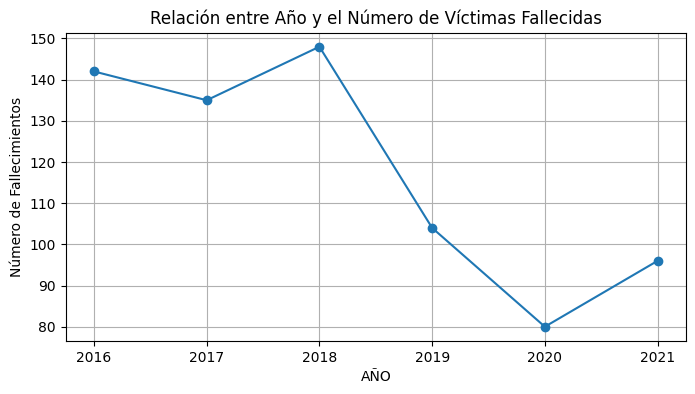

In [12]:
victimas_anual_o = accidentes_obitos.groupby('ANIO')['VICTIMAS'].count().reset_index()

plt.figure(figsize=(8, 4))
plt.plot(victimas_anual_o['ANIO'], victimas_anual_o['VICTIMAS'], marker='o', linestyle='-')
plt.title('Relación entre Año y el Número de Víctimas Fallecidas')
plt.xlabel('AÑO')
plt.ylabel('Número de Fallecimientos')
plt.grid(True)

plt.show()

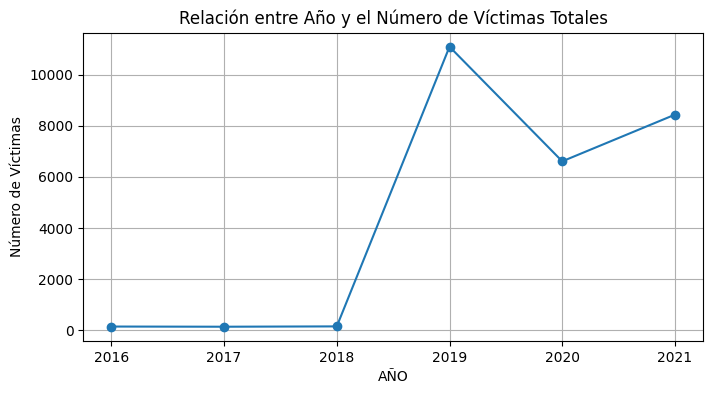

In [13]:
victimas_anual = accidentes.groupby('ANIO')['VICTIMAS'].count().reset_index()

plt.figure(figsize=(8, 4))
plt.plot(victimas_anual['ANIO'], victimas_anual['VICTIMAS'], marker='o', linestyle='-')
plt.title('Relación entre Año y el Número de Víctimas Totales')
plt.xlabel('AÑO')
plt.ylabel('Número de Víctimas')
plt.grid(True)

plt.show()

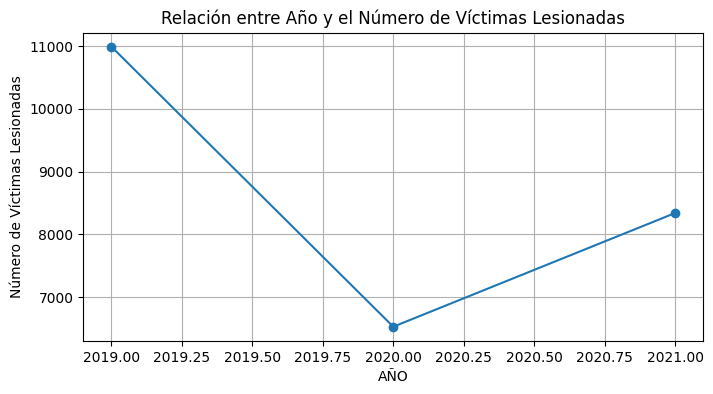

In [14]:
victimas_anual_lesiones = accidentes_lesiones.groupby('ANIO')['VICTIMAS'].count().reset_index()

plt.figure(figsize=(8, 4))  # Ajusta el tamaño de la gráfica según tus preferencias
plt.plot(victimas_anual_lesiones['ANIO'], victimas_anual_lesiones['VICTIMAS'], marker='o', linestyle='-')
plt.title('Relación entre Año y el Número de Víctimas Lesionadas')
plt.xlabel('AÑO')
plt.ylabel('Número de Víctimas Lesionadas')
plt.grid(True)

plt.show()

#### MES

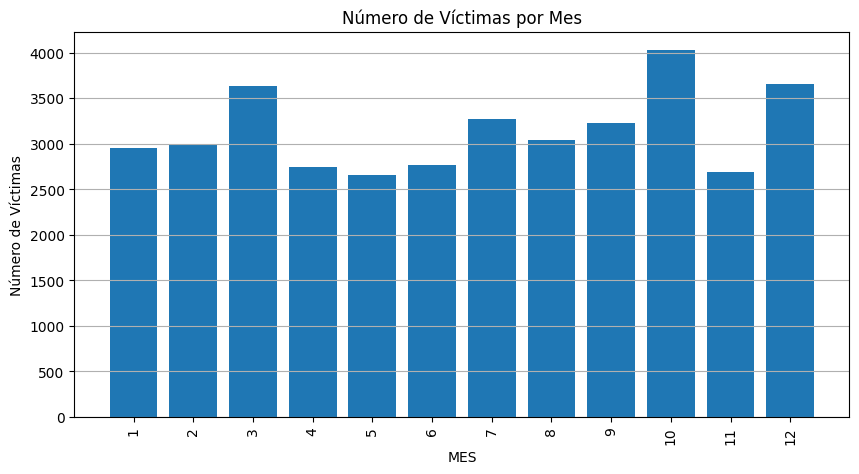

In [15]:
# Agrupa por comuna y suma las víctimas
victimas_mes = accidentes.groupby('MES')['VICTIMAS'].sum().reset_index()

# Filtrar comunas con víctimas
victimas_mes = victimas_mes[victimas_mes['VICTIMAS'] > 0]

# Ajustar los índices para que coincidan con la posición en el eje x
victimas_mes = victimas_mes.reset_index(drop=True)

# Crea la gráfica de barras
plt.figure(figsize=(10, 5))
bars = plt.bar(victimas_mes.index, victimas_mes['VICTIMAS'])
plt.title('Número de Víctimas por Mes')
plt.xlabel('MES')
plt.ylabel('Número de Víctimas')

# Ajustar las etiquetas para mostrar una de cada una
plt.xticks(rotation=90)
plt.xticks(range(len(victimas_mes.index)), victimas_mes['MES'], rotation=90)

plt.grid(axis='y')

# Mostrar la gráfica
plt.show()

### HORA

In [16]:
victimas_hora = ['HORA', 'VICTIMAS', 'OBITO']
accidentes_hora = accidentes[victimas_hora]

In [17]:
accidentes_hora = accidentes_hora[accidentes_hora['HORA'] != 'SD']

accidentes_hora['HORA'] = accidentes_hora['HORA'].str.slice(0, 2).astype('Int64')


In [18]:
accidentes_hora['HORA'].unique()

<IntegerArray>
[ 4,  1,  7,  0,  5, 18, 19, 15, 11, 22, 16,  9, 23,  6, 10, 17, 12,  8, 21,
 20, 14,  3,  2, 13]
Length: 24, dtype: Int64

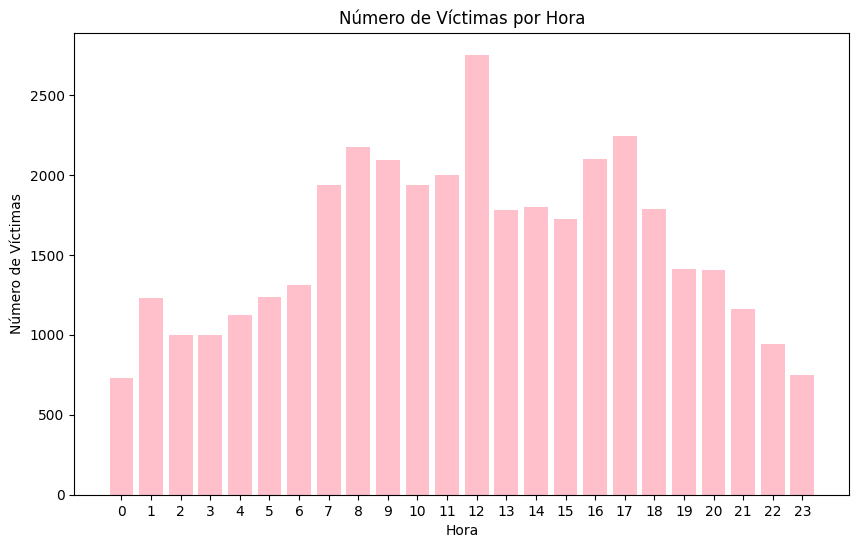

In [19]:
# Agrupar por hora y sumar las víctimas
victimas_por_hora = accidentes_hora.groupby('HORA')['VICTIMAS'].sum().reset_index()

# Reindexar para asegurarse de tener todas las horas
horas_completas = pd.DataFrame({'HORA': range(0, 24)}).set_index('HORA')
victimas_por_hora = horas_completas.merge(victimas_por_hora, how='left', left_index=True, right_on='HORA').fillna(0)

# Crear el gráfico de barras
plt.figure(figsize=(10, 6))
plt.bar(victimas_por_hora['HORA'], victimas_por_hora['VICTIMAS'], color='pink')
plt.title('Número de Víctimas por Hora')
plt.xlabel('Hora')
plt.ylabel('Número de Víctimas')
plt.xticks(range(24))  # Mostrar todas las horas en el eje X
plt.show()

## ROL

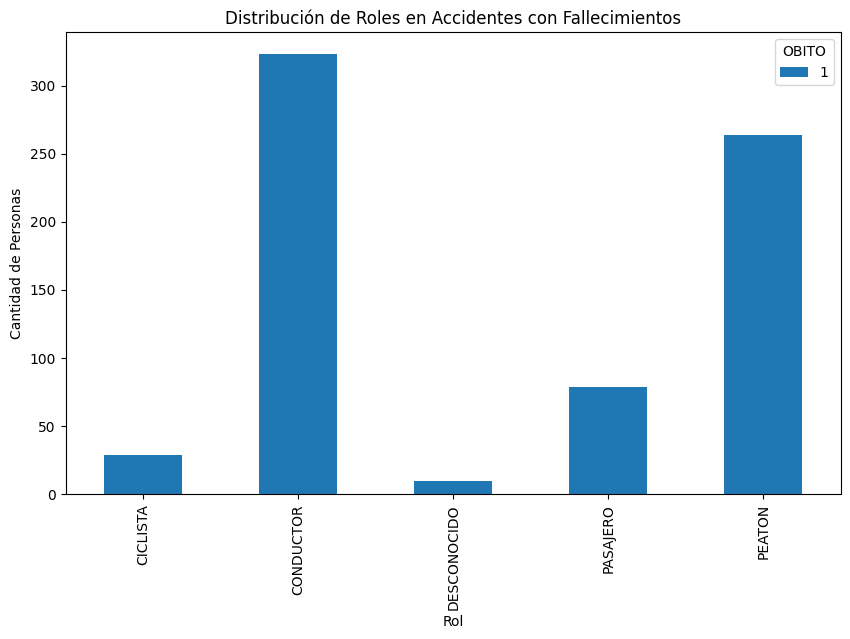

In [20]:
# Agrupar por rol y contar la cantidad de fallecimientos y lesionados
conteo_roles = accidentes_obitos.groupby(['ROL', 'OBITO']).size().unstack(fill_value=0)

# Crear el gráfico de barras
conteo_roles.plot(kind='bar', stacked=True, figsize=(10, 6))
plt.title('Distribución de Roles en Accidentes con Fallecimientos')
plt.xlabel('Rol')
plt.ylabel('Cantidad de Personas')
plt.show()

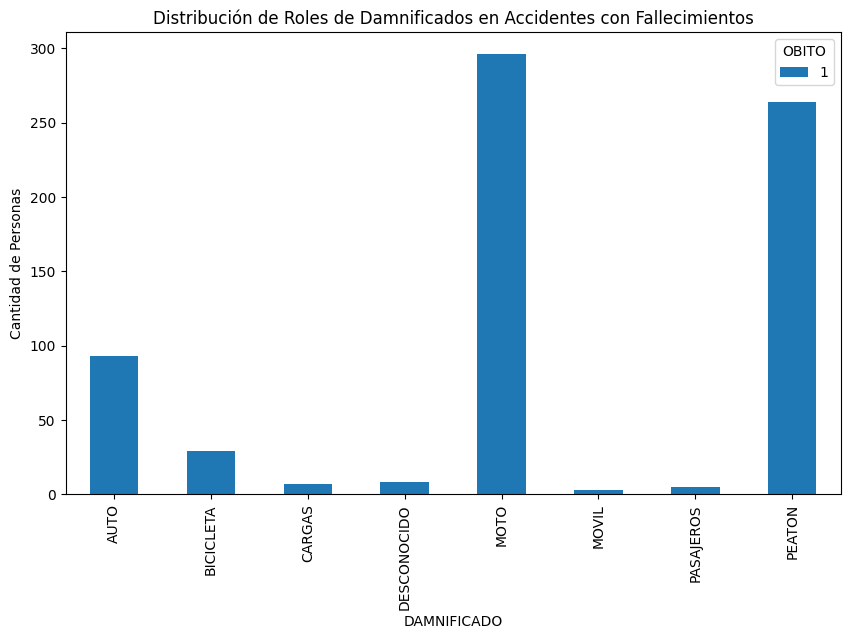

In [21]:
# Agrupar por rol y contar la cantidad de fallecimientos y lesionados
conteo_roles = accidentes_obitos.groupby(['DAMNIFICADO', 'OBITO']).size().unstack(fill_value=0)

# Crear el gráfico de barras
conteo_roles.plot(kind='bar', stacked=True, figsize=(10, 6))
plt.title('Distribución de Roles de Damnificados en Accidentes con Fallecimientos')
plt.xlabel('DAMNIFICADO')
plt.ylabel('Cantidad de Personas')
plt.show()

### VICTIMAS POR GÉNERO

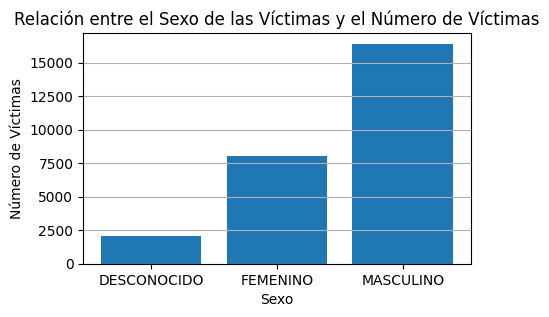

In [22]:

# Agrupa los datos por sexo y suma el número de víctimas en cada categoría
victimas_por_sexo = accidentes.groupby('SEXO')['VICTIMAS'].count().reset_index()

# Crea la gráfica de barras
plt.figure(figsize=(5, 3))  # Ajusta el tamaño de la gráfica según tus preferencias
plt.bar(victimas_por_sexo['SEXO'], victimas_por_sexo['VICTIMAS'])
plt.title('Relación entre el Sexo de las Víctimas y el Número de Víctimas')
plt.xlabel('Sexo')
plt.ylabel('Número de Víctimas')
plt.grid(axis='y')

# Mostrar la gráfica
plt.show()


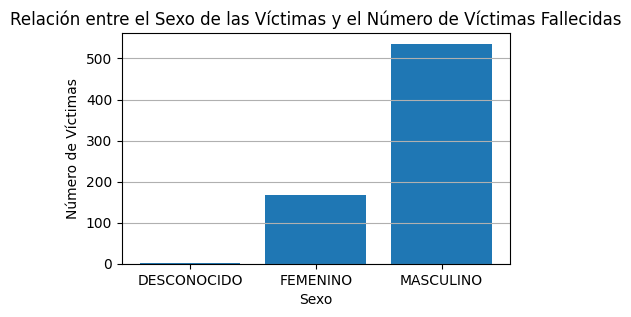

In [23]:

# Agrupa los datos por sexo y suma el número de víctimas en cada categoría
victimas_por_sexo_o = accidentes_obitos.groupby('SEXO')['VICTIMAS'].count().reset_index()

# Crea la gráfica de barras
plt.figure(figsize=(5, 3))  # Ajusta el tamaño de la gráfica según tus preferencias
plt.bar(victimas_por_sexo_o['SEXO'], victimas_por_sexo_o['VICTIMAS'])
plt.title('Relación entre el Sexo de las Víctimas y el Número de Víctimas Fallecidas')
plt.xlabel('Sexo')
plt.ylabel('Número de Víctimas')
plt.grid(axis='y')

# Mostrar la gráfica
plt.show()

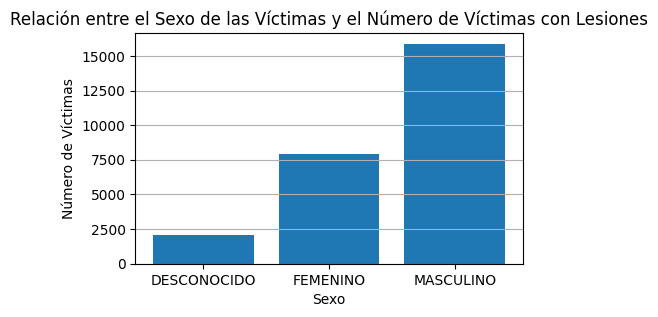

In [24]:

# Agrupa los datos por sexo y suma el número de víctimas en cada categoría
victimas_por_sexo_l = accidentes_lesiones.groupby('SEXO')['VICTIMAS'].count().reset_index()

# Crea la gráfica de barras
plt.figure(figsize=(5, 3))  # Ajusta el tamaño de la gráfica según tus preferencias
plt.bar(victimas_por_sexo_l['SEXO'], victimas_por_sexo_l['VICTIMAS'])
plt.title('Relación entre el Sexo de las Víctimas y el Número de Víctimas con Lesiones')
plt.xlabel('Sexo')
plt.ylabel('Número de Víctimas')
plt.grid(axis='y')

# Mostrar la gráfica
plt.show()

### VICTIMAS POR EDAD

In [25]:
columnasres = ['EDAD', 'VICTIMAS', 'OBITO']
accidentes_edad = accidentes[columnasres]

In [26]:
accidentes_edad

,EDAD,VICTIMAS,OBITO
0,19,1,1
1,70,1,1
2,30,1,1
3,18,1,1
4,29,1,1
...,...,...,...
26556,29,1,0
26557,28,2,0
26558,52,2,0
26559,23,1,0


In [27]:
# Crear la columna "RANGO" basada en las edades
bins = [0, 12, 19, 40, 65, float('inf')]
labels = ['NIÑXS', 'ADOLESCENTES', 'JOVENES', 'MAYORES', 'ANCIANOS']

accidentes_edad['RANGO'] = pd.cut(accidentes_edad['EDAD'], bins=bins, labels=labels, right=False)


In [28]:
accidentes_edad

,EDAD,VICTIMAS,OBITO,RANGO
0,19,1,1,JOVENES
1,70,1,1,ANCIANOS
2,30,1,1,JOVENES
3,18,1,1,ADOLESCENTES
4,29,1,1,JOVENES
...,...,...,...,...
26556,29,1,0,JOVENES
26557,28,2,0,JOVENES
26558,52,2,0,MAYORES
26559,23,1,0,JOVENES


In [29]:
apariciones_por_rango = accidentes_edad['RANGO'].value_counts().sort_index()
apariciones_por_rango


RANGO
NIÑXS            4576
ADOLESCENTES      568
JOVENES         12919
MAYORES          6969
ANCIANOS         1529
Name: count, dtype: int64

In [30]:
# Crear DataFrame para OBITO igual a 1 (accidentes mortales)
accidentes_edad_obito = accidentes_edad[accidentes_edad['OBITO'] == 1]

# Crear DataFrame para OBITO igual a 0 (accidentes con lesiones)
accidentes_edad_lesiones = accidentes_edad[accidentes_edad['OBITO'] == 0]

In [31]:
accidentes_edad_obito

,EDAD,VICTIMAS,OBITO,RANGO
0,19,1,1,JOVENES
1,70,1,1,ANCIANOS
2,30,1,1,JOVENES
3,18,1,1,ADOLESCENTES
4,29,1,1,JOVENES
...,...,...,...,...
700,43,1,1,MAYORES
701,27,1,1,JOVENES
702,60,1,1,MAYORES
703,53,1,1,MAYORES


In [32]:
obito_por_rango = accidentes_edad_obito['RANGO'].value_counts().sort_index()
obito_por_rango


RANGO
NIÑXS            57
ADOLESCENTES     20
JOVENES         332
MAYORES         184
ANCIANOS        112
Name: count, dtype: int64

In [33]:
accidentes_edad_lesiones

,EDAD,VICTIMAS,OBITO,RANGO
704,0,1,0,NIÑXS
705,57,1,0,MAYORES
706,0,1,0,NIÑXS
707,0,1,0,NIÑXS
708,45,4,0,MAYORES
...,...,...,...,...
26556,29,1,0,JOVENES
26557,28,2,0,JOVENES
26558,52,2,0,MAYORES
26559,23,1,0,JOVENES


In [34]:
lesiones_por_rango = accidentes_edad_lesiones['RANGO'].value_counts().sort_index()
lesiones_por_rango

RANGO
NIÑXS            4519
ADOLESCENTES      548
JOVENES         12587
MAYORES          6785
ANCIANOS         1417
Name: count, dtype: int64

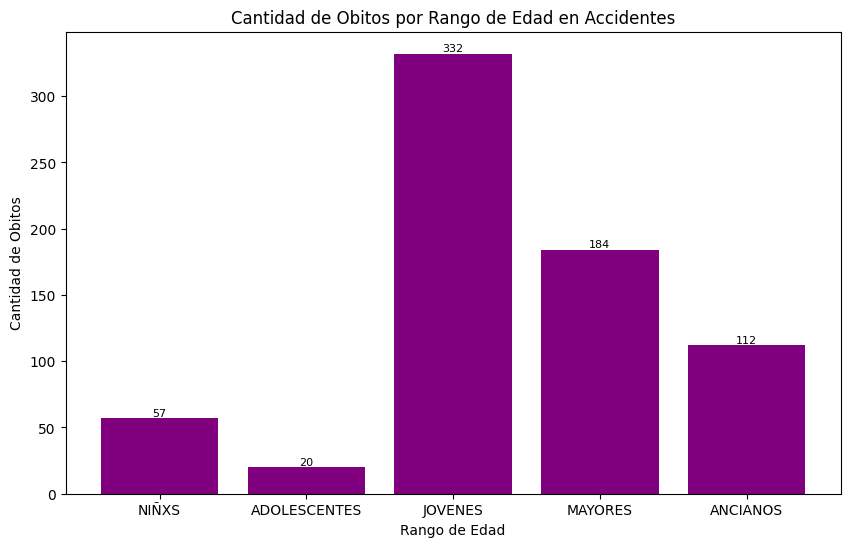

In [35]:
# Graficar la cantidad de víctimas por rango
plt.figure(figsize=(10, 6))
bars = plt.bar(obito_por_rango.index, obito_por_rango, color='purple')
plt.xlabel('Rango de Edad')
plt.ylabel('Cantidad de Obitos')
plt.title('Cantidad de Obitos por Rango de Edad en Accidentes')

# Agregar etiquetas con los valores de cada rango
for bar in bars:
    yval = bar.get_height()
    plt.text(bar.get_x() + bar.get_width()/2, yval, int(yval), ha='center', va='bottom', color='black', fontsize=8)

plt.show()

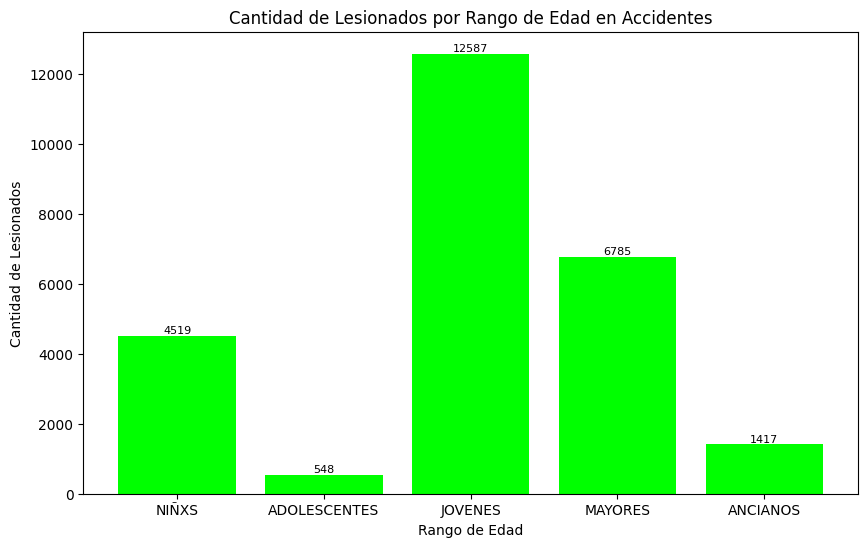

In [36]:
# Graficar la cantidad de víctimas por rango
plt.figure(figsize=(10, 6))
bars = plt.bar(lesiones_por_rango.index, lesiones_por_rango, color='lime')
plt.xlabel('Rango de Edad')
plt.ylabel('Cantidad de Lesionados')
plt.title('Cantidad de Lesionados por Rango de Edad en Accidentes')

# Agregar etiquetas con los valores de cada rango
for bar in bars:
    yval = bar.get_height()
    plt.text(bar.get_x() + bar.get_width()/2, yval, int(yval), ha='center', va='bottom', color='black', fontsize=8)

plt.show()

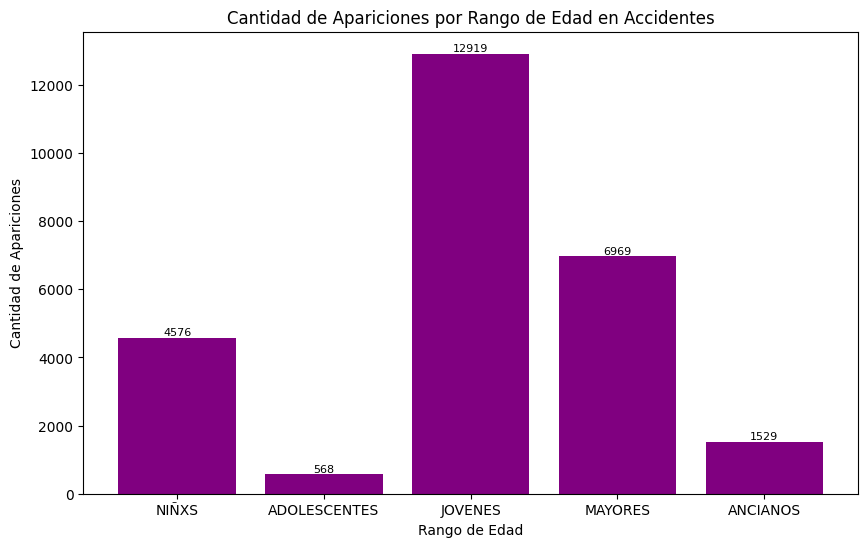

In [37]:
# Graficar la cantidad de víctimas por rango
plt.figure(figsize=(10, 6))
bars = plt.bar(apariciones_por_rango.index, apariciones_por_rango, color='purple')
plt.xlabel('Rango de Edad')
plt.ylabel('Cantidad de Apariciones')
plt.title('Cantidad de Apariciones por Rango de Edad en Accidentes')

# Agregar etiquetas con los valores de cada rango
for bar in bars:
    yval = bar.get_height()
    plt.text(bar.get_x() + bar.get_width()/2, yval, int(yval), ha='center', va='bottom', color='black', fontsize=8)

plt.show()

### MEDIO

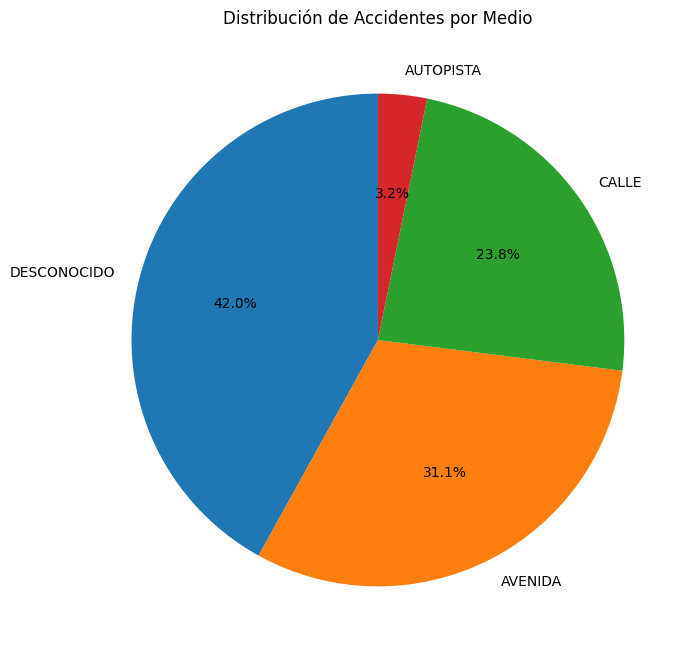

In [38]:
conteo_medios = accidentes['MEDIO'].value_counts()

# Crear el gráfico de torta
plt.figure(figsize=(8, 8))
plt.pie(conteo_medios, labels=conteo_medios.index, autopct='%1.1f%%', startangle=90)
plt.title('Distribución de Accidentes por Medio')
plt.show()

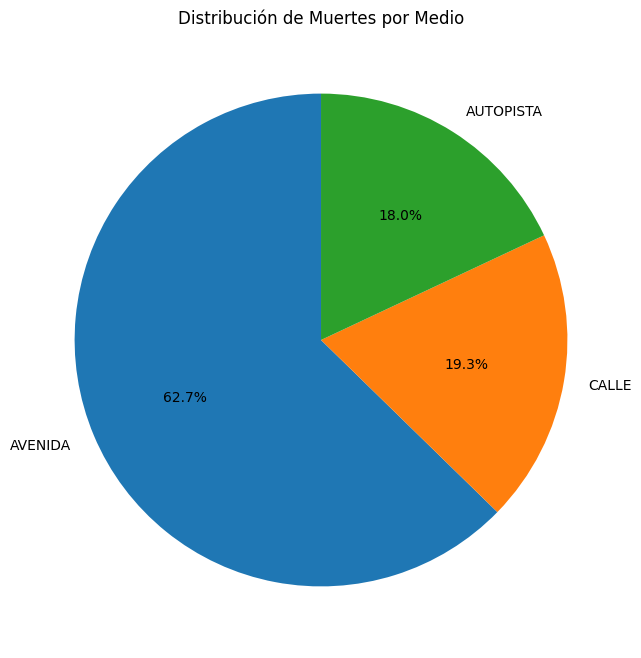

In [39]:
conteo_medios_o = accidentes_obitos['MEDIO'].value_counts()

# Crear el gráfico de torta
plt.figure(figsize=(8, 8))
plt.pie(conteo_medios_o, labels=conteo_medios_o.index, autopct='%1.1f%%', startangle=90)
plt.title('Distribución de Muertes por Medio')
plt.show()

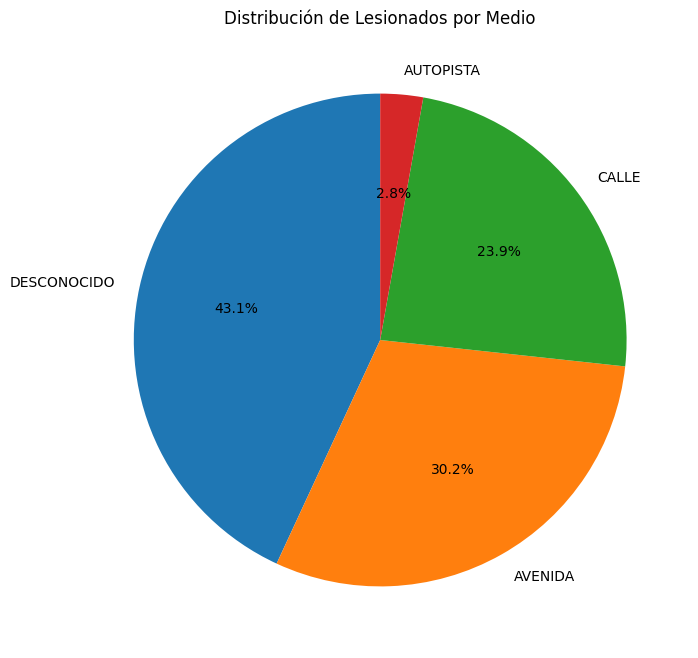

In [40]:
conteo_medios_l = accidentes_lesiones['MEDIO'].value_counts()

# Crear el gráfico de torta
plt.figure(figsize=(8, 8))
plt.pie(conteo_medios_l, labels=conteo_medios_l.index, autopct='%1.1f%%', startangle=90)
plt.title('Distribución de Lesionados por Medio')
plt.show()

## KPI's

In [59]:
poblacion = pd.read_csv('./DATA/PBP_CO_1020 - PBP_CO_1020.csv')

In [60]:
poblacion

,Proyecciones de población por comuna y sexo. Ciudad de Buenos Aires. Años 2010/2025,Unnamed: 1,Unnamed: 2,Unnamed: 3,Unnamed: 4,Unnamed: 5,Unnamed: 6,Unnamed: 7,Unnamed: 8,Unnamed: 9,Unnamed: 10,Unnamed: 11,Unnamed: 12,Unnamed: 13,Unnamed: 14,Unnamed: 15,Unnamed: 16
0,Ambos sexos,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,Comuna,2010,2011,2012,2013,2014,2015,2016,2017,2018,2019,2020,2021,2022,2023,2024,2025
2,Total,3.028.481,3.033.639,3.038.860,3.044.076,3.049.229,3.054.267,3.059.122,3.063.728,3.068.043,3.072.029,3.075.646,3.078.836,3.081.550,3.083.770,3.085.483,3.086.680
3,1,243.946,245.308,246.689,248.069,249.433,250.770,252.053,253.271,254.408,255.457,256.405,257.235,257.934,258.497,258.922,259.205
4,2,150.714,150.573,150.428,150.278,150.130,149.985,149.848,149.720,149.607,149.510,149.430,149.371,149.337,149.328,149.345,149.389
5,3,191.323,191.536,191.750,191.963,192.171,192.375,192.573,192.763,192.945,193.115,193.276,193.425,193.560,193.682,193.790,193.884
6,4,234.933,235.497,236.071,236.646,237.214,237.769,238.303,238.809,239.279,239.712,240.100,240.437,240.716,240.937,241.096,241.193
7,5,185.301,185.544,185.789,186.034,186.276,186.512,186.740,186.956,187.159,187.348,187.518,187.670,187.800,187.907,187.991,188.053
8,6,183.046,183.309,183.576,183.843,184.105,184.363,184.611,184.846,185.067,185.271,185.456,185.620,185.760,185.875,185.964,186.028
9,7,236.838,237.389,237.946,238.505,239.057,239.597,240.116,240.607,241.065,241.484,241.861,242.188,242.460,242.674,242.828,242.921


In [67]:
# Calcular el número de homicidios en siniestros viales para cada semestre
obitos_semestre = accidentes_obitos.groupby(['ANIO', 'SEMESTRE'])['VICTIMAS'].sum()

# Calcular la población total en CABA en un promedio de los ultimos 6 años
poblacion_caba =(3059122 + 3063728 + 3068043 + 3072029 + 3075646 + 3078836) / 6

# Calcular la tasa de homicidios en siniestros viales para cada semestre
tasa_obitos_semestre = (obitos_semestre / poblacion_caba) * 100000

# Calcular la reducción en la tasa de homicidios en siniestros viales
reduccion_obitos = ((tasa_obitos_semestre.shift(-1) - tasa_obitos_semestre) / tasa_obitos_semestre) * 100

In [68]:
obitos_semestre

ANIO  SEMESTRE
2016  1           66
      2           80
2017  1           75
      2           78
2018  1           75
      2           85
2019  1           59
      2           47
2020  1           30
      2           56
2021  1           54
      2           42
Name: VICTIMAS, dtype: int64

In [70]:
tasa_obitos_semestre

ANIO  SEMESTRE
2016  1           2.150140
      2           2.606230
2017  1           2.443341
      2           2.541075
2018  1           2.443341
      2           2.769120
2019  1           1.922095
      2           1.531160
2020  1           0.977336
      2           1.824361
2021  1           1.759206
      2           1.368271
Name: VICTIMAS, dtype: float64

In [69]:
reduccion_obitos

ANIO  SEMESTRE
2016  1           21.212121
      2           -6.250000
2017  1            4.000000
      2           -3.846154
2018  1           13.333333
      2          -30.588235
2019  1          -20.338983
      2          -36.170213
2020  1           86.666667
      2           -3.571429
2021  1          -22.222222
      2                 NaN
Name: VICTIMAS, dtype: float64

<Axes: xlabel='ANIO,SEMESTRE'>

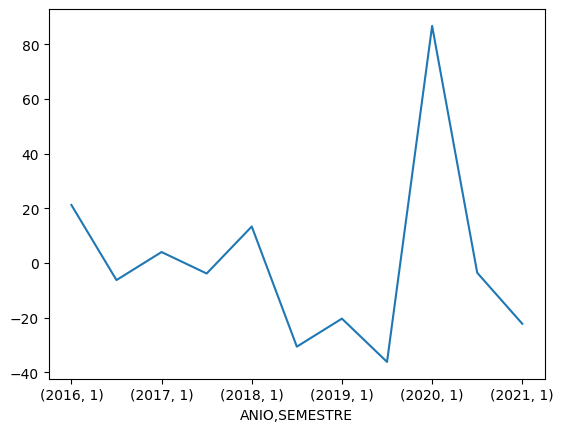

In [74]:
reduccion_obitos.plot()

### CONCLUSION
El presente indicador clave de rendimiento (KPI) se centra en evaluar la evolución de la tasa de homicidios en siniestros viales en la Ciudad Autónoma de Buenos Aires (CABA) a lo largo de varios años, comparando los dos últimos semestres. La tendencia general de este KPI experimenta variaciones anuales, observándose disminuciones significativas en algunos periodos y aumentos en otros. En el año 2020, se destacó un aumento sustancial en la tasa de homicidios durante el primer semestre (86.66%), seguido de una mejora en el segundo semestre (10%), posiblemente atribuible a factores como el impacto de la pandemia o medidas de seguridad vial. Respecto al año 2021, la falta de información, especialmente en el segundo semestre, complica una evaluación precisa del rendimiento. La comparación entre semestres revela que la reducción deseada del 10% se logra en algunos casos, mientras que en otros no. Sería beneficioso realizar un análisis más profundo de las causas detrás de las variaciones en la tasa de homicidios en siniestros viales, considerando posibles cambios en políticas de seguridad vial, mejoras en la infraestructura vial, o la influencia de eventos externos como la pandemia.

### KPI 2

In [94]:

obito_moto_anual = accidentes_obitos[accidentes_obitos['DAMNIFICADO'] == 'MOTO'].groupby('ANIO')['ID'].count()

# Se filtran datos para accidentes mortales de motociclistas y se calcula la cantidad anual

reduccion_obitos_moto = (accidentes_obitos[accidentes_obitos['DAMNIFICADO'] == 'MOTO'].groupby('ANIO')['ID'].count().pct_change(fill_value=0) * 100)


In [95]:
obito_moto_anual

ANIO
2016    63
2017    52
2018    57
2019    50
2020    29
2021    45
Name: ID, dtype: int64

In [92]:
reduccion_obitos_moto

ANIO
2016          inf
2017   -17.460317
2018     9.615385
2019   -12.280702
2020   -42.000000
2021    55.172414
Name: ID, dtype: float64

<Axes: xlabel='ANIO'>

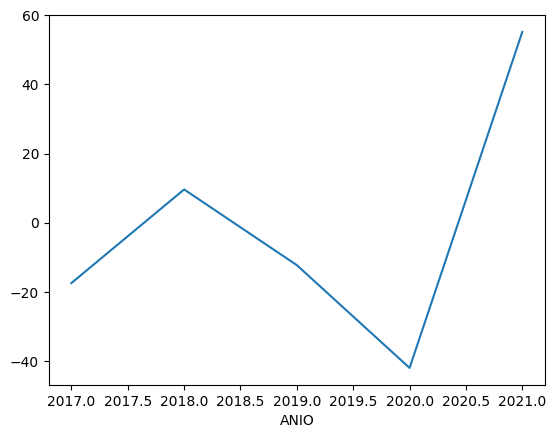

In [97]:
reduccion_obitos_moto.plot()

### CONCLUSION

Se espera una reducción del 7% en la cantidad de obitos en Moto, se aprecia una reducción sustancial del 42 % hacia el inicio del 2020, que luego comienza a incrementar enel transcurso del 2020 llegando a un aumento del 55.17% hacia el 2021. Se puede intuir que el tiempo de aislamiento durante la pandemia aportó en la reducción de accidentes seguidos de obitos, para luego incrementarse vertiginosamente,hacia la vuelta a las calles luego dela pandemia, lo cual influira en muchos factores referentes al estadodeánimo y psicologico de la población, como económico.


### MAPAS
#### 1. ZONAS CON MAYOR TASA DE ACCIDENTES CON OBITO
#### 2. COMPARACIÓN ENTRE ACCIDENTES CON LESIONES (AZUL) Y ACCIDENTES CON ÓBITOS (ROJO)

In [209]:
mapa = accidentes.loc[accidentes['OBITO'] == 1, ['X', 'Y']]
mapa = mapa.dropna(subset=['X', 'Y'])
print(mapa)

               X          Y
0     -58.475340 -34.687570
1     -58.508775 -34.669777
2     -58.390403 -34.631894
3     -58.465039 -34.680930
4     -58.387183 -34.622466
...          ...        ...
700   -58.467398 -34.651178
701   -58.472934 -34.619847
702   -58.470668 -34.650217
703   -58.379762 -34.586796
17239 -58.466449 -34.700942

[705 rows x 2 columns]


In [210]:
mapa = mapa.dropna(subset=['X', 'Y'])

centro_mapa = [mapa['Y'].mean(), mapa['X'].mean()]
mapa_obitos = folium.Map(location=centro_mapa, zoom_start=12)
heat_data = [[row['Y'], row['X']] for index, row in mapa.iterrows()]
HeatMap(heat_data, radius=17, cmap='inferno', gradient={.5: 'purple', .6: 'blue', 1: 'red'}).add_to(mapa_obitos)

mapa_obitos.save('mapa_obitos.html')

In [211]:
mapa_obitos

In [212]:
mapa1 = accidentes[['X', 'Y', 'OBITO']].copy()

mapa1 = mapa1.dropna(subset=['X', 'Y'])

In [213]:
mapa1

,X,Y,OBITO
0,-58.475340,-34.687570,1
1,-58.508775,-34.669777,1
2,-58.390403,-34.631894,1
3,-58.465039,-34.680930,1
4,-58.387183,-34.622466,1
...,...,...,...
26556,-58.513477,-34.659714,0
26557,-58.488327,-34.641753,0
26558,-58.488327,-34.641753,0
26559,-58.382894,-34.583083,0


In [214]:
centro_mapa = [mapa1['Y'].mean(), mapa1['X'].mean()]
mapaObitosyLesiones = folium.Map(location=centro_mapa, zoom_start=13)

for index, row in mapa1.iterrows():
    if row['OBITO'] == 1:
        radius = 10  
        color = 'red'
    else:
        radius = .8
        color = 'blue'
    folium.CircleMarker(
        location=[row['Y'], row['X']],
        radius=radius,
        color=color,
        fill=True,
        fill_color=color,
        fill_opacity=0.4,
        popup=f"Ubicación: {row['Y']}, {row['X']}\nOBITO: {row['OBITO']}"
    ).add_to(mapaObitosyLesiones)

mapaObitosyLesiones.save('mapaObitosyLesiones.html')

In [215]:
mapaObitosyLesiones

In [216]:
reduccion_obitos.to_csv('DATA/kpi1.csv', index=False)

In [217]:
reduccion_obitos_moto.to_csv('DATA/kpi2.csv', index=False)